In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd 
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator 
import matplotlib.pyplot as plt
from PIL import Image
from shutil import copyfile
import os
from sklearn.utils import shuffle

# Define function to use later

In [ ]:
def append_ext(fn):
  """Adding '.jpg' at the of images id"""
  return fn+".jpg"

In [ ]:
def copy_images(df, dst_name):
  """
  Copy images to dedicated directory
  ----------------------------------
  PARAMS as follows:
  df - dataframe object that has column "Id" of pictures to be copied
  dst_name - folder name where images will be copied
  """
  
  directory_destination = '/content/drive/MyDrive/Pewpularuty/' + dst_name 
  os.mkdir(directory_destination)
  for id in df['Id']:
    source = "/content/drive/MyDrive/Pewpularuty/train/" + id
    target = directory_destination + '/' + id
    copyfile(source, target)

In [ ]:
def print_images(path, num_of_images, images_list = [], do_shuffle = False, show_id = False):
  """
  Function to print number of images from folder
  ----------------------------------------------
  PARAMS as follows:
  path - directory where images are located. Must end by symbol '/' to define a folder
  
  num_of_images - number of images to print. Number should be dividable by 4
  
  images_list - list of images id to plot. By default = None, so will be formed from provided directory
  
  do_shuffle - boolean argument. By default defined as False. If necessary to print random images out of a band 

  show_id - boolean argument. If necessary to print image id as X axes label should be passed True

  ----------------------------------------------
  Example to call:
  print_images('/content/drive/MyDrive/Pewpularuty/club_100/',30)
  """
  if len(images_list) == 0:
    images_list = os.listdir(path)
  else:
    images_list = images_list.tolist()
  if do_shuffle == True:
     images_list = shuffle(images_list)
  fig = plt.figure(figsize=(20,20))
  for i in range(num_of_images):
    rows = num_of_images/4
    fig.add_subplot(rows, 4, i+1)
    im = Image.open(path + images_list[i])
    plt.imshow(im)

    if show_id == True:
      plt.xlabel(images_list[i])
    else: 
  # get rid of exis to make plotting compacts 
  # plus making images closer tot each other
      plt.xticks([])
    plt.yticks([])
    plt.tight_layout()



# Loading the data

In [ ]:
meta = pd.read_csv("/content/drive/MyDrive/Pewpularuty/train/train.csv")

In [ ]:
meta.head(5)

,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42
2,0013fd999caf9a3efe1352ca1b0d937e,0,1,1,1,0,0,0,0,1,1,0,0,28
3,0018df346ac9c1d8413cfcc888ca8246,0,1,1,1,0,0,0,0,0,0,0,0,15
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72


In [ ]:
labels = meta[['Id','Pawpularity']]
train_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
#labels.rename(columns={'Id': 'filename'}, inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
labels["Id"] = labels["Id"].apply(append_ext)
labels.head(3)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Id,Pawpularity
0,0007de18844b0dbbb5e1f607da0606e0.jpg,63
1,0009c66b9439883ba2750fb825e1d7db.jpg,42
2,0013fd999caf9a3efe1352ca1b0d937e.jpg,28


In [ ]:
labels[labels['Pawpularity'] ==100].head(3)

,Id,Pawpularity
19,00768659c1c90409f81dcdecbd270513.jpg,100
50,013f86ed0e765b189990d3d5ac28bd7d.jpg,100
86,0254f54b148543442373d5aad45b2d1a.jpg,100


# Visual inspection of some groups of pictures


### Looking at pictures with Score = 100

In [ ]:
# filter out only images that have Score = 100
club_100 = labels[labels['Pawpularity'] == 100]

In [ ]:
# copy all these image to a dedicated folder to work with
copy_images(club_100, 'club_100')

In [ ]:
# check if images copied correctly 
images_list = os.listdir('/content/drive/MyDrive/Pewpularuty/club_100/') 
number_files = len(images_list)
number_files

288

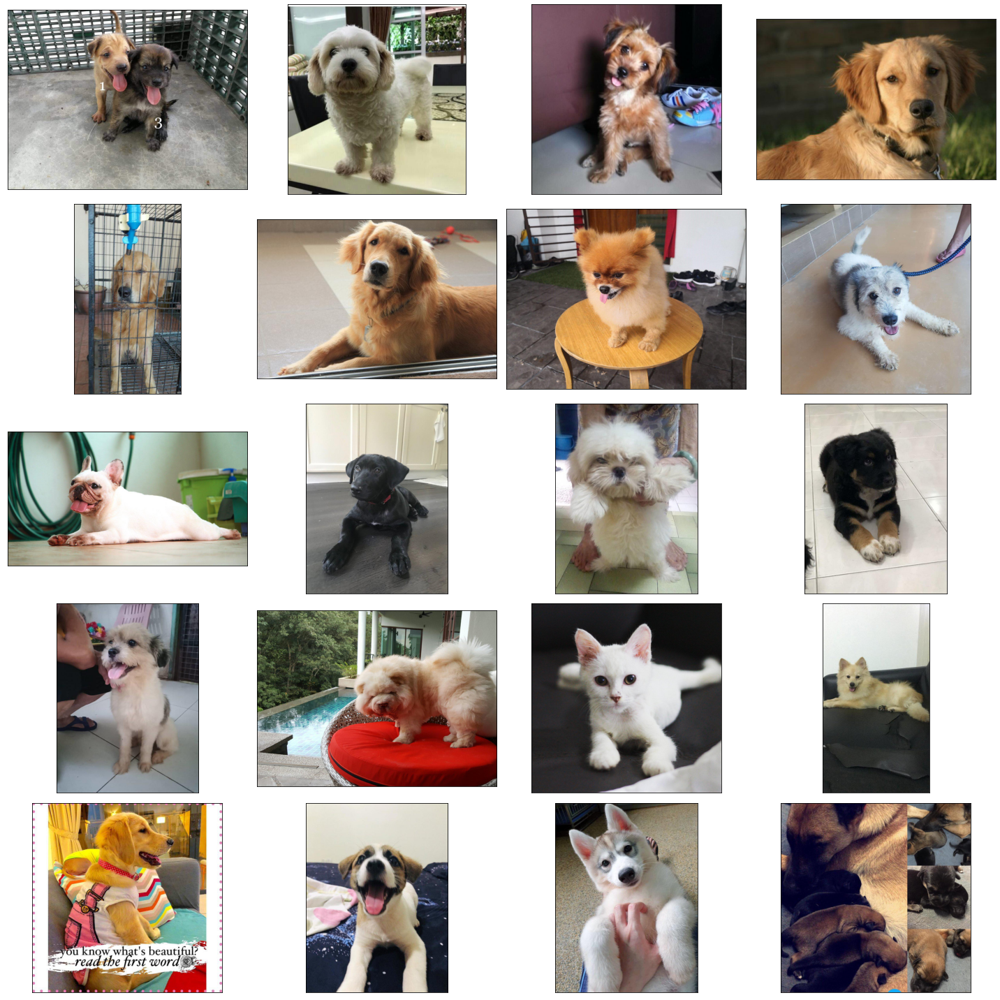

In [ ]:
path = '/content/drive/MyDrive/Pewpularuty/club_100/'
num_of_images = 20
print_images(path, num_of_images, images_list = [], do_shuffle = True, show_id = False)

### Looking at pictures with score <= 15

In [ ]:
club_less_15 = labels[labels['Pawpularity'] <= 15]
len(club_less_15)

748

In [ ]:
# copy all these image to a dedicated folder to work with
copy_images(club_less_15, 'club_less_15')

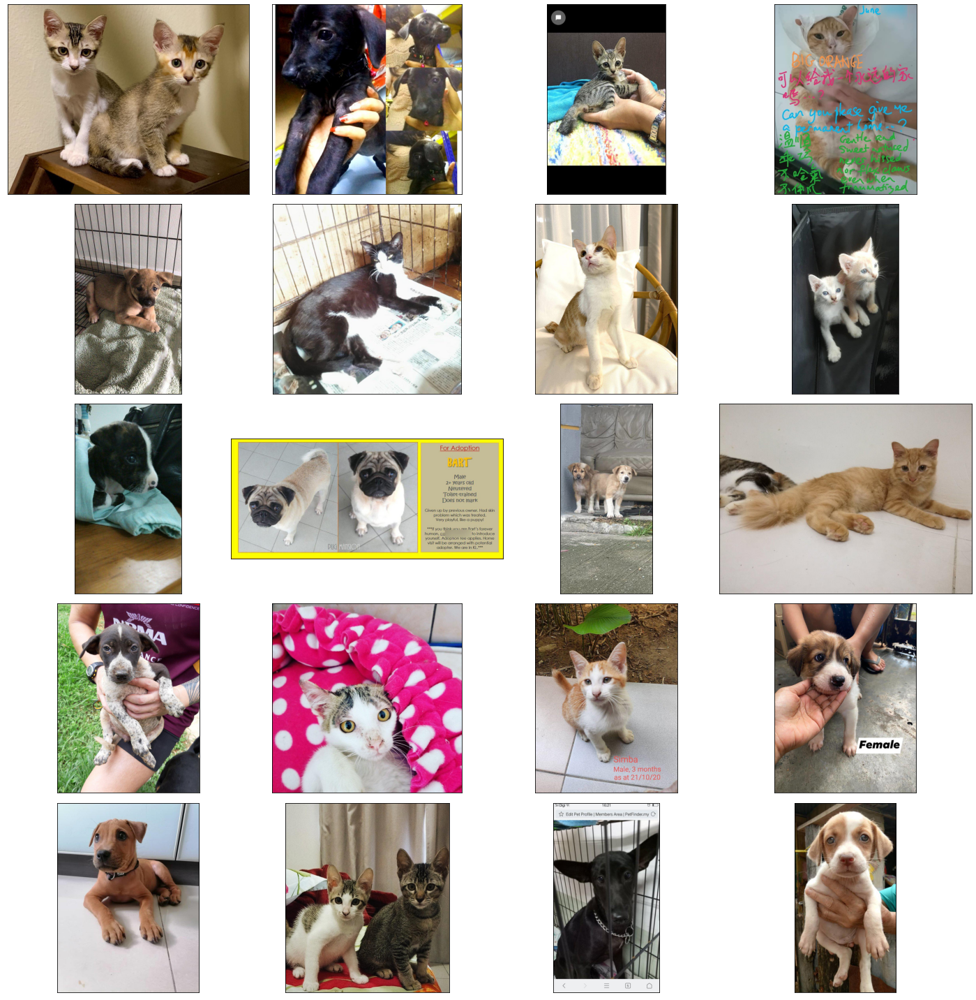

In [ ]:
#print_images(path, num_of_images, images_list = None, do_shuffle = False, show_id = False):
path = '/content/drive/MyDrive/Pewpularuty/club_less_15/'
num_of_images = 20
print_images(path, num_of_images, images_list = [], do_shuffle = True, show_id = False)

### Visual inspection of pictures with certain metadata mark

In [ ]:
occlusion = meta[meta['Occlusion'] == 1][['Id','Occlusion','Pawpularity']]
len(occlusion)

1705

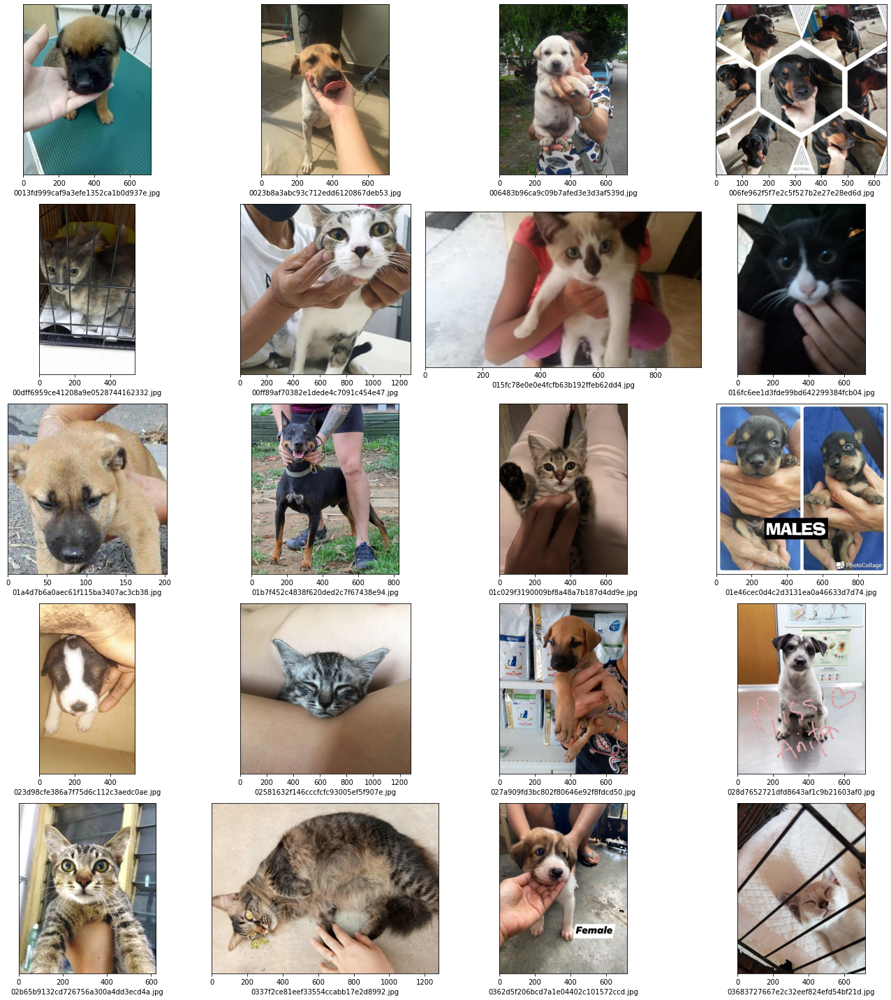

In [ ]:
path = "/content/drive/MyDrive/Pewpularuty/train/"
images_list = occlusion["Id"].apply(append_ext)
num_of_images = 20

print_images(path, num_of_images, images_list = images_list, do_shuffle = False, show_id = True)

In [ ]:
collage = meta[meta['Collage'] == 1][['Id','Collage','Pawpularity']]
len(collage)

492

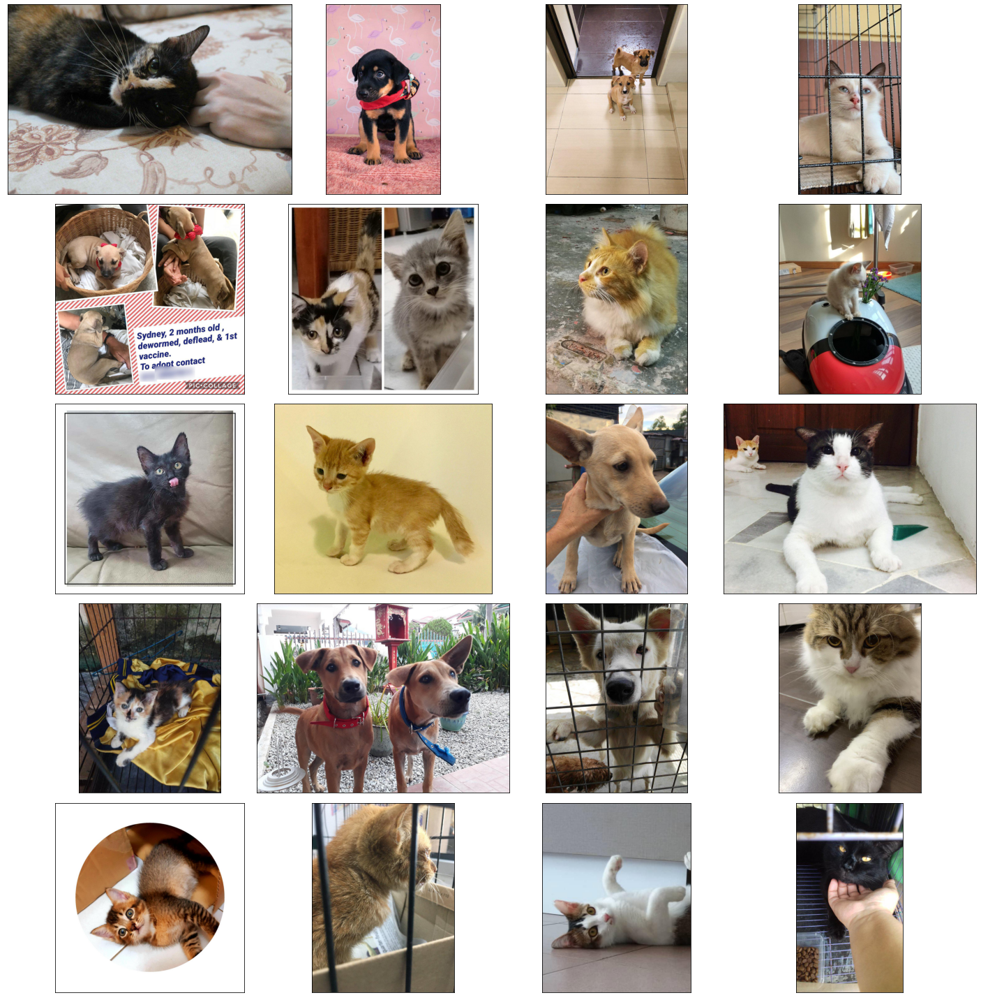

In [ ]:
path = "/content/drive/MyDrive/Pewpularuty/train/"
images_list = collage["Id"].apply(append_ext)
num_of_images = 20
print_images(path, num_of_images, images_list = images_list, do_shuffle = False, show_id = False)

### Note: 
collage column has falsy values. 

In [ ]:
group = meta[meta['Group'] == 1][['Id','Group','Pawpularity']]
len(group)

1282

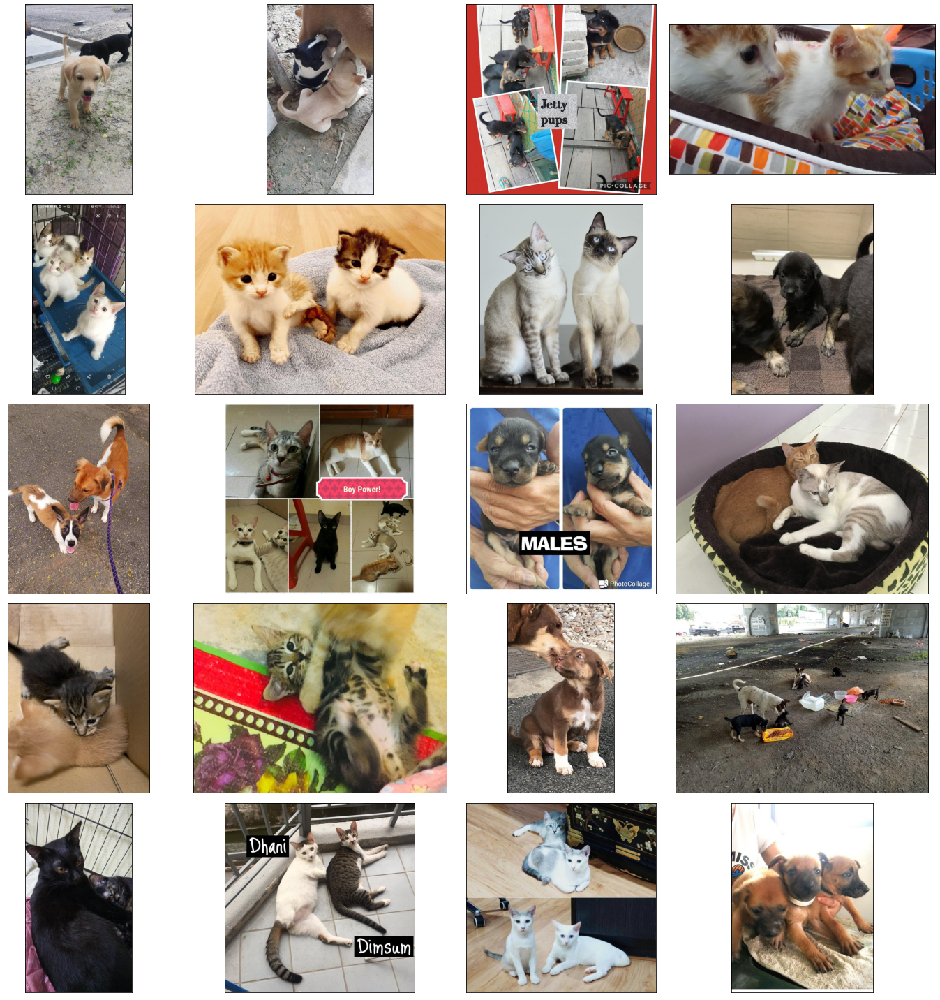

In [ ]:
path = "/content/drive/MyDrive/Pewpularuty/train/"
images_list = group["Id"].apply(append_ext)
num_of_images = 20
print_images(path, num_of_images, images_list = images_list, do_shuffle = False, show_id = False)

In [ ]:
accessory = meta[meta['Accessory'] == 1][['Id','Accessory','Pawpularity']]
len(accessory)

672

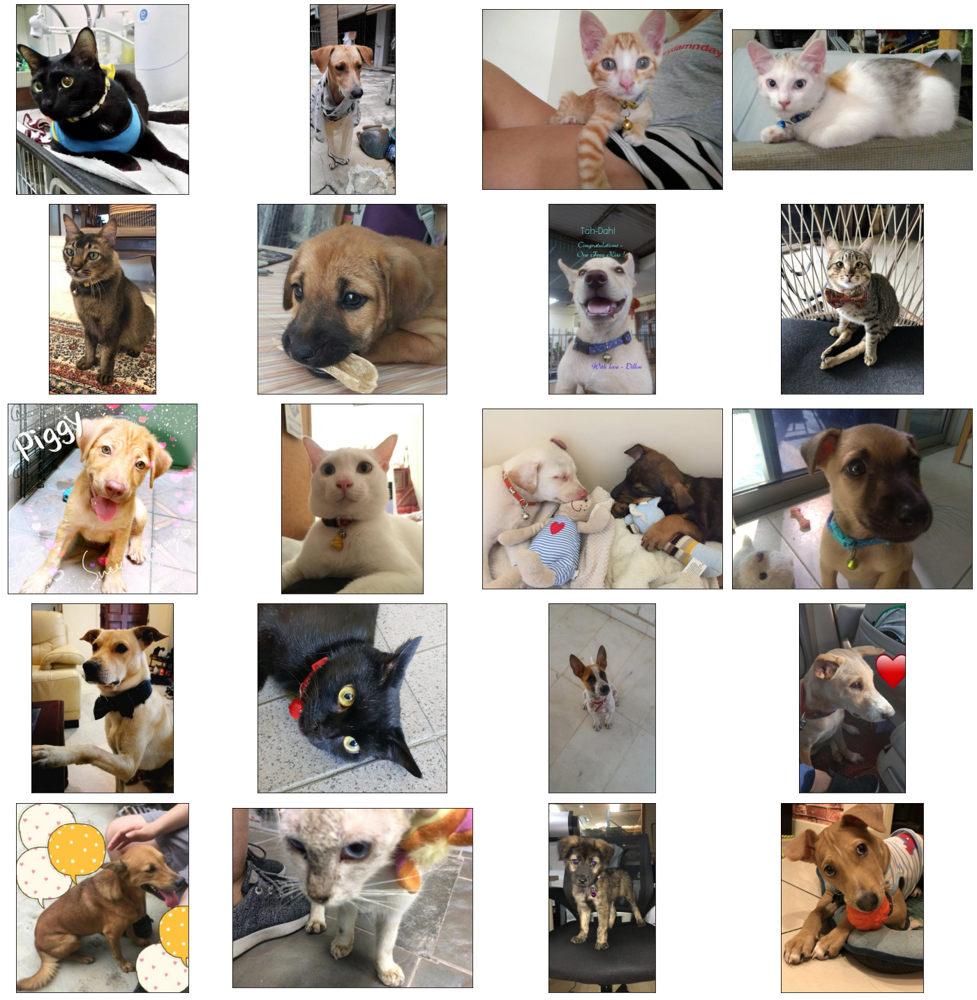

In [ ]:
path = "/content/drive/MyDrive/Pewpularuty/train/"
images_list = accessory["Id"].apply(append_ext)
num_of_images = 20
print_images(path, num_of_images, images_list = images_list, do_shuffle = False, show_id = False)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f2d6c65e710>,
      dtype=object)

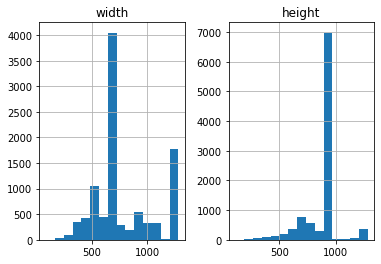

In [ ]:
df1 = pd.read_csv('/content/drive/MyDrive/Pewpularuty/image_sizes.csv')
df1.hist(bins=15)

In [ ]:
size_inspect = df1[df1['height'] < 300]

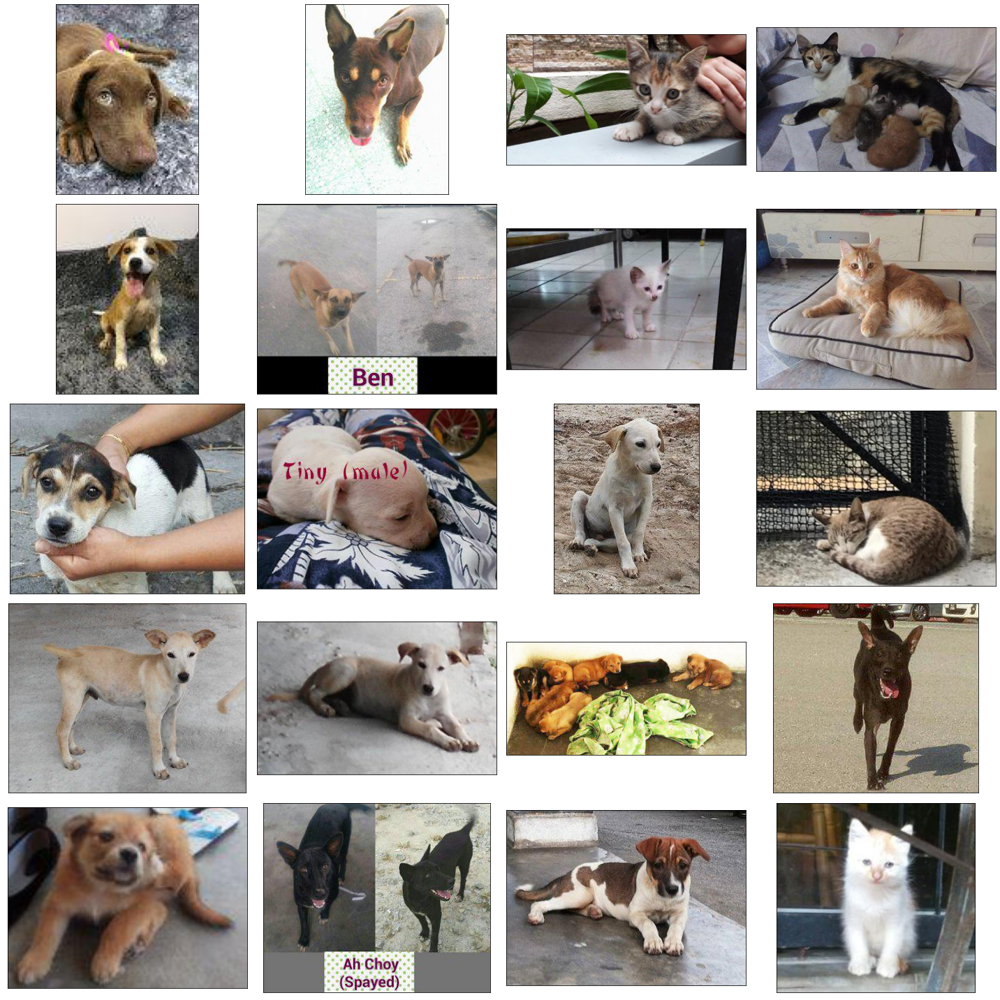

In [ ]:
path = "/content/drive/MyDrive/Pewpularuty/train/"
images_list = size_inspect['filename']
num_of_images = 20
print_images(path, num_of_images, images_list = images_list, do_shuffle = True, show_id = False)